# RandomForest XAI 적용

SHAP 분석 시 순위에 없던 장르_ 컬럼이 LIME에서는 상위에 올라와있는 것을 확인

이에 LSA로 장르, 국적을 압축해서 한번 더 진행한 결과 

장르 압축 컬럼이 LIME에서 상위를 차지하지 않았음

2가지 해석이 가능해는데,
- LSA 적용으로 장르 컬럼에 대한 해석가능성이 감소되었음
- 각 샘플의 불안정성이 완화되어 일관된 해석이 가능해짐

상영일수에 영향이 있었던 장르_애니메이션, 국적_한국 이 아니라 다른 컬럼(장르_서부, 장르_서사 등)이 중요한 영향을 끼치는 것으로 결과가 나왔었기에

sparse한 장르, 국적 피쳐를 압축하는 것이 바람직할 것으로 보임

In [1]:
import matplotlib.pyplot as plt
import matplotlib as mpl

mpl.rcParams['font.family'] = 'NanumGothic' # matplotlib 한글깨짐 해결
mpl.rcParams['axes.unicode_minus'] = False

In [2]:
import pandas as pd

pd.set_option('display.max_seq_items', None)

### 전처리

In [3]:
import pandas as pd
file_path = "final_data_rebounds.csv"
df_origin = pd.read_csv(file_path)

In [4]:
cols_to_drop = ['영화명', '개봉일', '장르', '국적', '감독', '배급사', '대표국적', '등급', '제작사', '배우','조회일', '순위', '매출액', '매출액(점유율)', '매출액증감',
       '매출액증감율(전일대비)', '관객수', '관객수증감(전일대비)', '관객수증감율(전일대비)', '스크린수', '상영횟수',]
df = df_origin.drop(columns=cols_to_drop)

In [5]:
df.fillna(df.mean(), inplace=True) # 결측값은 평균으로 채움

# XAI 적용

### 모델 학습
재반등횟수 7일 사용

In [6]:
df = df.drop(columns=["재반등횟수", "3일뒤_재반등횟수", "7일뒤_재반등횟수", "10일뒤_재반등횟수"])

In [7]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

# 피처와 타겟 분리
X = df.drop('상영일수', axis=1) 
y = df['상영일수']

# 훈련/테스트 데이터 분할
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42
)

In [8]:
# 회귀용 Random Forest
rf_regressor = RandomForestRegressor(
    n_estimators=100,
    max_depth=10,
    random_state=42,
    n_jobs=-1
)

rf_regressor.fit(X_train, y_train)
y_pred = rf_regressor.predict(X_test)

# 회귀 성능 평가
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print(f"MSE: {mse:.4f}")
print(f"R² Score: {r2:.4f}")

MSE: 31.9942
R² Score: 0.9367


In [10]:
from sklearn.model_selection import RandomizedSearchCV
param_dist = {
    'n_estimators': [100, 200, 500, 1000],
    'max_depth': [None, 10, 20, 30, 50],
    'min_samples_split': [2, 5, 10, 20],
    'min_samples_leaf': [1, 2, 4, 10],
    'max_features': [None, 'sqrt', 'log2', 0.2, 0.5, 0.8]
}
search = RandomizedSearchCV(
    rf_regressor, param_distributions=param_dist,
    n_iter=50, cv=5, scoring='neg_mean_squared_error',
    random_state=42, n_jobs=-1
)
search.fit(X_train, y_train)
print(search.best_params_, -search.best_score_)

{'n_estimators': 100, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.5, 'max_depth': None} 227.59954039432697


In [9]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

# 최적 하이퍼파라미터
best_params = {
    'n_estimators': 100,
    'max_depth': None,
    'min_samples_split': 2,
    'min_samples_leaf': 1,
    'max_features': 0.5,
    'random_state': 42,
    'n_jobs': -1
}

# 모델 생성
rf_regressor = RandomForestRegressor(**best_params)

# 학습
rf_regressor.fit(X_train, y_train)

# 예측
y_pred = rf_regressor.predict(X_test)

# 성능 평가
mse = mean_squared_error(y_test, y_pred)
r2  = r2_score(y_test, y_pred)
print(f"MSE: {mse:.4f}")
print(f"R² Score: {r2:.4f}")


MSE: 25.9230
R² Score: 0.9487


Feature Importances:
스크린수_sum           0.196999
스크린수_sum_after     0.193327
스크린수_mean          0.071772
스크린수_volatility    0.062612
관객수_sum_after      0.050387
                     ...   
장르_공연실황            0.000000
장르_공포              0.000000
장르_서부극             0.000000
장르_모험              0.000000
장르_콘서트             0.000000
Length: 99, dtype: float64


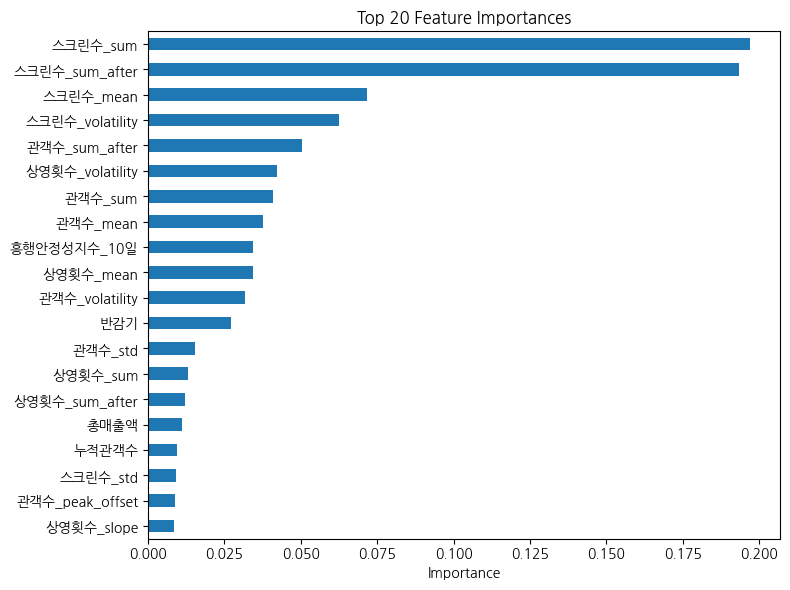

In [20]:
# 학습된 RandomForestRegressor 모델의 feature importances 출력 예시

import pandas as pd
import numpy as np

# 1) 모델이 이미 학습된 상태라고 가정합니다.
#    rf_regressor = RandomForestRegressor(**best_params)
#    rf_regressor.fit(X_train, y_train)

# 2) 피처 중요도 추출
importances = rf_regressor.feature_importances_

# 3) 피처 이름 확보 (X_train이 DataFrame인 경우)
if isinstance(X_train, pd.DataFrame):
    feature_names = X_train.columns
else:
    # numpy 배열인 경우, 인덱스로 대체
    feature_names = [f"feature_{i}" for i in range(importances.shape[0])]

# 4) Series로 변환 후 정렬
feat_imp = pd.Series(importances, index=feature_names)
feat_imp_sorted = feat_imp.sort_values(ascending=False)

# 5) 콘솔에 출력
print("Feature Importances:")
print(feat_imp_sorted)

# (선택) 시각화
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
feat_imp_sorted.head(20).plot(kind='barh')  # 상위 20개만 시각화
plt.gca().invert_yaxis()  # 중요도 높은 순서대로 위에 표시
plt.xlabel("Importance")
plt.title("Top 20 Feature Importances")
plt.tight_layout()
plt.show()


## SHAP 적용

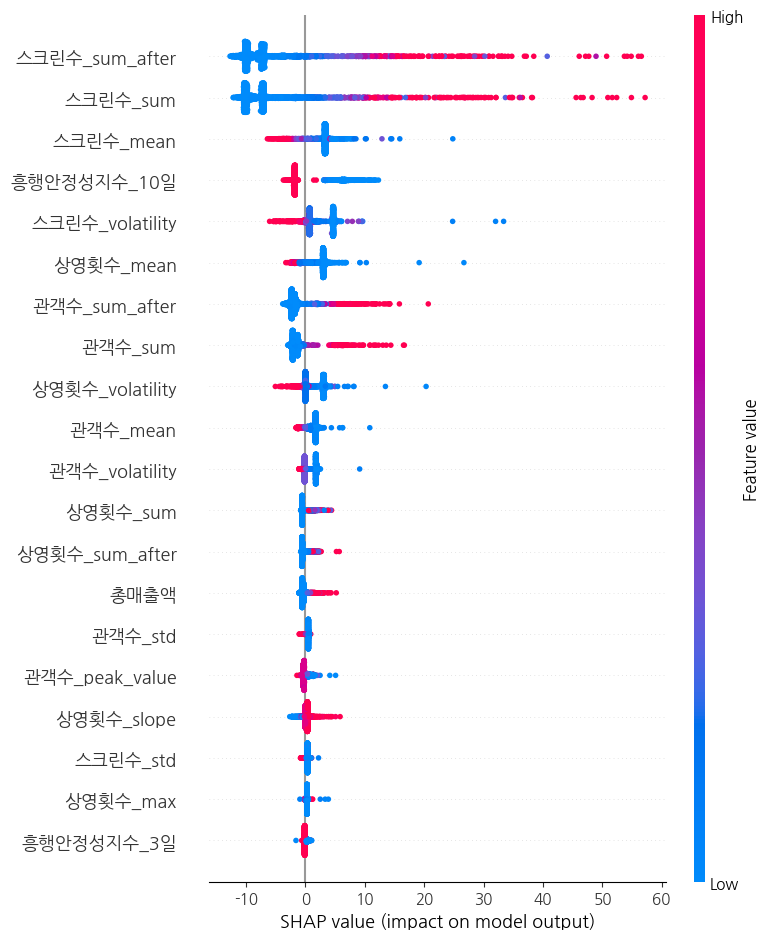

In [10]:
import shap

explainer = shap.TreeExplainer(rf_regressor)  
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test)

## Lime 적용

In [11]:
from IPython.core.display import HTML, display
from lime.lime_tabular import LimeTabularExplainer

def explain_movie_by_index(idx):
    """
    df_origin 기준 idx를 받아서
    1) 해당 샘플의 예측/실제값과 오차를 출력
    2) LIME 설명을 흰 배경으로 notebook 에 렌더
    """
    # 1) 테스트 세트에 없으면 경고
    if idx not in X_test.index:
        print(f"[!] 인덱스 {idx} 는 테스트 세트에 없습니다. df_origin 및 train_test_split 결과를 확인하세요.")
        return
    
    # 2) 원본 영화명, 특성, 예측값, 실제값
    movie_name = df_origin.loc[idx, '영화명']
    sample = X_test.loc[idx]
    pred = rf_regressor.predict(sample.values.reshape(1, -1))[0]
    actual = y_test.loc[idx]
    
    # 3) 결과 출력
    print("=== 샘플 분석 결과 ===")
    print(f"영화명      : {movie_name}")
    print(f"예측 상영일수: {pred:.2f}")
    print(f"실제 상영일수: {actual}")
    print(f"절대 오차    : {abs(pred - actual):.2f}")
    print(f"상대 오차    : {abs(pred - actual)/actual*100:.2f}%\n")
    
    # 4) LIME 설명 (흰 배경 강제)
    explainer = LimeTabularExplainer(
        X_train.values,
        feature_names=X_train.columns,
        mode='regression'
    )
    exp = explainer.explain_instance(
        sample.values,
        rf_regressor.predict,
        num_features=10
    )
    print("=== LIME 설명 ===")
    # raw HTML 가져와서 흰 배경 div 로 감싸기
    lime_html = exp.as_html(show_table=True)
    styled = f"""
    <div style="
        background-color: white;
        padding: 10px;
        border-radius: 4px;
    ">
        {lime_html}
    </div>
    """
    display(HTML(styled))


### 결과 확인

- 상영일수가 200일이 넘어가는 영화에 대해서 오차가 커지는 경향이 있음

- 30일 이상에서는 흥행안정성 지수가 포함됨

- 별로 중요하게 고려하지 않았던 타겟 인코딩 변수가 포함됨
    - 서부 영화가 아니라서 낮은 샘플도 있고, 서부 영화가 아니라서 높은 샘플도 있음

In [12]:
explain_movie_by_index(8)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 극장판 아이돌리쉬 세븐; 라이브 4비트 비욘드 더 피리어드 - 데이 1
예측 상영일수: 207.43
실제 상영일수: 276
절대 오차    : 68.57
상대 오차    : 24.84%



c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== LIME 설명 ===


In [13]:
explain_movie_by_index(12)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 엘리멘탈
예측 상영일수: 157.49
실제 상영일수: 192
절대 오차    : 34.51
상대 오차    : 17.97%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [14]:
explain_movie_by_index(101)

=== 샘플 분석 결과 ===
영화명      : 기적
예측 상영일수: 83.82
실제 상영일수: 88
절대 오차    : 4.18
상대 오차    : 4.75%



c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [15]:
explain_movie_by_index(132)

=== 샘플 분석 결과 ===
영화명      : 기생충
예측 상영일수: 107.60
실제 상영일수: 78
절대 오차    : 29.60
상대 오차    : 37.95%



c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [16]:
explain_movie_by_index(621)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 이승윤 콘서트 도킹 : 리프트오프
예측 상영일수: 31.87
실제 상영일수: 33
절대 오차    : 1.13
상대 오차    : 3.42%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [17]:
explain_movie_by_index(1215)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 블랙핑크 월드투어 [본 핑크] 인 시네마
예측 상영일수: 19.07
실제 상영일수: 16
절대 오차    : 3.07
상대 오차    : 19.19%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [18]:
explain_movie_by_index(2542)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 비틀즈 겟 백: 루프탑 콘서트
예측 상영일수: 4.06
실제 상영일수: 3
절대 오차    : 1.06
상대 오차    : 35.33%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [19]:
explain_movie_by_index(3516)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 흉터
예측 상영일수: 2.00
실제 상영일수: 2
절대 오차    : 0.00
상대 오차    : 0.00%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


# LSA 압축 후 진행

범주형 변수에 대한 해석 확인을 위해 진행

기존 점수(MSE 25, R 0.95)와 차이 미미(26, 0.94)

In [42]:
df = df.drop(columns=["재반등횟수", "3일뒤_재반등횟수", "7일뒤_재반등횟수", "10일뒤_재반등횟수"])

In [44]:
import pandas as pd
import numpy as np
from sklearn.decomposition import TruncatedSVD
from sklearn.preprocessing import StandardScaler

# 1) 원-핫 컬럼 식별
genre_cols   = [c for c in df.columns if c.startswith('장르_') and not c.endswith('_점수')]
country_cols = [c for c in df.columns if c.startswith('국적_') and not c.endswith('_점수')]
onehot_cols  = genre_cols + country_cols

# 2) 원-핫 데이터 선택 및 스케일링
X_onehot = df[onehot_cols].values
scaler = StandardScaler(with_mean=False)  # 희소 행렬에선 with_mean=False
X_scaled = scaler.fit_transform(X_onehot)

# 3) Truncated SVD로 누적 분산 70%를 설명하는 컴포넌트 개수 찾기
n_features = X_scaled.shape[1]
svd_full = TruncatedSVD(n_components=n_features-1, random_state=42)
svd_full.fit(X_scaled)
cum_var = np.cumsum(svd_full.explained_variance_ratio_)
n_components_70 = np.argmax(cum_var >= 0.70) + 1
print(f"70% 분산을 설명하는 컴포넌트 개수: {n_components_70}")

# 4) 실제 차원 축소
svd = TruncatedSVD(n_components=n_components_70, random_state=42)
X_reduced = svd.fit_transform(X_scaled)

# 5) 압축 피쳐를 DataFrame으로 변환 및 기존 데이터와 결합
reduced_cols = [f'LSA_GC_{i+1}' for i in range(n_components_70)]
df_reduced = pd.DataFrame(X_reduced, columns=reduced_cols, index=df.index)

# 원핫 컬럼 제거 후 병합
df_final = pd.concat([
    df.drop(columns=onehot_cols),
    df_reduced
], axis=1)

print(f"원본 컬럼 수: {len(df.columns)} → 압축 후 컬럼 수: {len(df_final.columns)}")
print(f"총 설명 분산 비율: {svd.explained_variance_ratio_.sum():.4f}")

70% 분산을 설명하는 컴포넌트 개수: 27
원본 컬럼 수: 100 → 압축 후 컬럼 수: 83
총 설명 분산 비율: 0.7113


In [45]:
df_reduced.to_csv('compressed_features.csv', index=False, encoding='utf-8-sig')

In [46]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

# 피처와 타겟 분리
X = df_final.drop('상영일수', axis=1) 
y = df_final['상영일수']

# 훈련/테스트 데이터 분할
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42
)

In [47]:
# 회귀용 Random Forest
rf_regressor = RandomForestRegressor(
    n_estimators=100,
    max_depth=10,
    random_state=42,
    n_jobs=-1
)

rf_regressor.fit(X_train, y_train)
y_pred = rf_regressor.predict(X_test)

# 회귀 성능 평가
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print(f"MSE: {mse:.4f}")
print(f"R² Score: {r2:.4f}")

MSE: 37.4639
R² Score: 0.9258


In [60]:
from sklearn.model_selection import RandomizedSearchCV
param_dist = {
    'n_estimators': [100, 200, 500, 1000],
    'max_depth': [None, 10, 20, 30, 50],
    'min_samples_split': [2, 5, 10, 20],
    'min_samples_leaf': [1, 2, 4, 10],
    'max_features': [None, 'sqrt', 'log2', 0.2, 0.5, 0.8]
}
search = RandomizedSearchCV(
    rf_regressor, param_distributions=param_dist,
    n_iter=50, cv=5, scoring='neg_mean_squared_error',
    random_state=42, n_jobs=-1
)
search.fit(X_train, y_train)
print(search.best_params_, -search.best_score_)

{'n_estimators': 100, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_features': 0.5, 'max_depth': 20} 247.6954262960622


In [61]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

best_params = {
    'n_estimators': 100,
    'max_depth': 20,
    'min_samples_split': 2,
    'min_samples_leaf': 2,
    'max_features': 0.5,
    'random_state': 42,
    'n_jobs': -1
}

# 모델 생성
rf_regressor = RandomForestRegressor(**best_params)

# 학습
rf_regressor.fit(X_train, y_train)

# 예측
y_pred = rf_regressor.predict(X_test)

# 성능 평가
mse = mean_squared_error(y_test, y_pred)
r2  = r2_score(y_test, y_pred)
print(f"MSE: {mse:.4f}")
print(f"R² Score: {r2:.4f}")


MSE: 26.6418
R² Score: 0.9472


##### SHAP

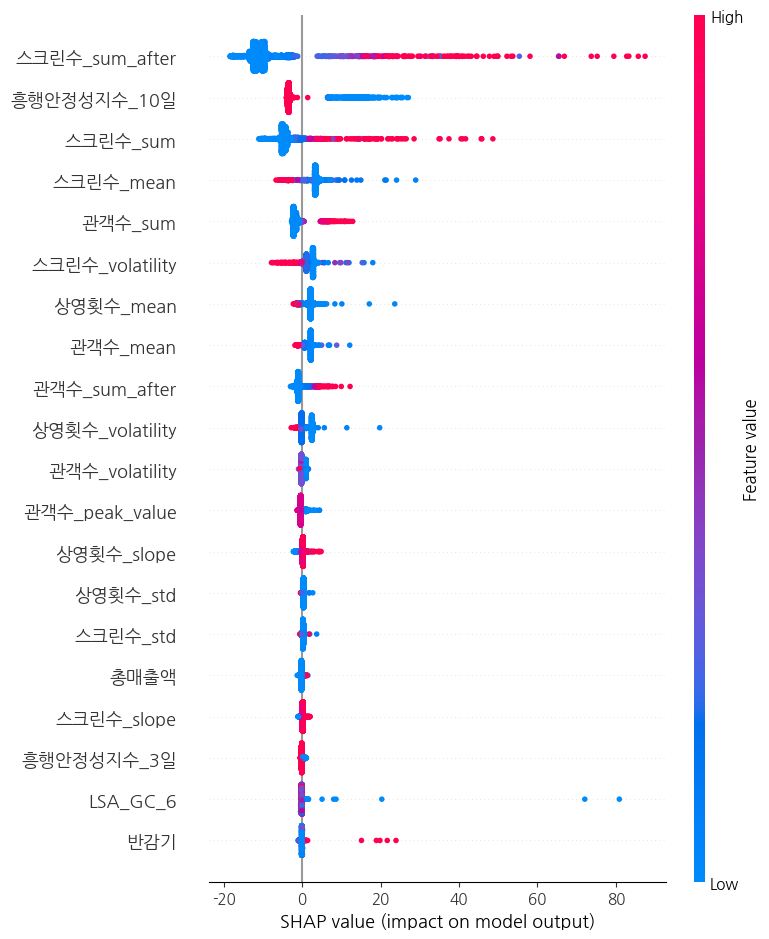

In [49]:
import shap

explainer = shap.TreeExplainer(rf_regressor)  
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test)

##### LIME

In [50]:
from IPython.core.display import HTML, display
from lime.lime_tabular import LimeTabularExplainer

def explain_movie_by_index(idx):
    """
    df_origin 기준 idx를 받아서
    1) 해당 샘플의 예측/실제값과 오차를 출력
    2) LIME 설명을 흰 배경으로 notebook 에 렌더
    """
    # 1) 테스트 세트에 없으면 경고
    if idx not in X_test.index:
        print(f"[!] 인덱스 {idx} 는 테스트 세트에 없습니다. df_origin 및 train_test_split 결과를 확인하세요.")
        return
    
    # 2) 원본 영화명, 특성, 예측값, 실제값
    movie_name = df_origin.loc[idx, '영화명']
    sample = X_test.loc[idx]
    pred = rf_regressor.predict(sample.values.reshape(1, -1))[0]
    actual = y_test.loc[idx]
    
    # 3) 결과 출력
    print("=== 샘플 분석 결과 ===")
    print(f"영화명      : {movie_name}")
    print(f"예측 상영일수: {pred:.2f}")
    print(f"실제 상영일수: {actual}")
    print(f"절대 오차    : {abs(pred - actual):.2f}")
    print(f"상대 오차    : {abs(pred - actual)/actual*100:.2f}%\n")
    
    # 4) LIME 설명 (흰 배경 강제)
    explainer = LimeTabularExplainer(
        X_train.values,
        feature_names=X_train.columns,
        mode='regression'
    )
    exp = explainer.explain_instance(
        sample.values,
        rf_regressor.predict,
        num_features=10
    )
    print("=== LIME 설명 ===")
    # raw HTML 가져와서 흰 배경 div 로 감싸기
    lime_html = exp.as_html(show_table=True)
    styled = f"""
    <div style="
        background-color: white;
        padding: 10px;
        border-radius: 4px;
    ">
        {lime_html}
    </div>
    """
    display(HTML(styled))

In [51]:
sorted_indices = sorted(X_test.index.tolist())
print("정렬된 테스트 데이터셋에 포함된 인덱스:")
print(sorted_indices)

정렬된 테스트 데이터셋에 포함된 인덱스:
[8, 12, 14, 15, 17, 23, 26, 29, 30, 31, 33, 37, 43, 44, 47, 50, 51, 61, 63, 65, 69, 70, 71, 73, 75, 79, 80, 84, 88, 90, 92, 93, 95, 96, 100, 101, 102, 106, 107, 108, 109, 110, 113, 120, 121, 124, 132, 134, 135, 142, 144, 149, 151, 156, 157, 167, 168, 177, 179, 181, 183, 184, 185, 188, 192, 195, 196, 198, 199, 203, 208, 210, 217, 219, 221, 227, 228, 230, 233, 238, 239, 240, 245, 247, 248, 251, 252, 254, 259, 263, 272, 279, 286, 287, 290, 291, 292, 293, 296, 297, 303, 304, 307, 308, 315, 319, 321, 322, 323, 324, 325, 332, 333, 334, 336, 339, 344, 346, 349, 350, 351, 354, 367, 371, 373, 380, 381, 387, 393, 401, 408, 410, 411, 414, 415, 416, 418, 420, 422, 425, 426, 428, 429, 432, 437, 438, 439, 443, 445, 447, 452, 453, 457, 465, 468, 469, 471, 472, 473, 476, 478, 479, 485, 486, 491, 497, 498, 501, 505, 506, 518, 527, 530, 533, 534, 535, 538, 543, 544, 549, 553, 555, 561, 564, 565, 566, 576, 577, 582, 584, 586, 589, 596, 598, 599, 604, 605, 607, 611, 613, 620, 621, 6

### 결과 확인

상위권 영화에 대해 기존보다 더 보수적인 판단

기존 결과에서 중요 피쳐로 선정되었던 장르 피쳐가 사라짐

In [52]:
explain_movie_by_index(8)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 극장판 아이돌리쉬 세븐; 라이브 4비트 비욘드 더 피리어드 - 데이 1
예측 상영일수: 210.14
실제 상영일수: 276
절대 오차    : 65.86
상대 오차    : 23.86%



c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== LIME 설명 ===


In [53]:
explain_movie_by_index(12)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 엘리멘탈
예측 상영일수: 166.30
실제 상영일수: 192
절대 오차    : 25.70
상대 오차    : 13.38%



c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== LIME 설명 ===


In [54]:
explain_movie_by_index(101)

=== 샘플 분석 결과 ===
영화명      : 기적
예측 상영일수: 83.56
실제 상영일수: 88
절대 오차    : 4.44
상대 오차    : 5.04%



c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [55]:
explain_movie_by_index(132)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 기생충
예측 상영일수: 90.57
실제 상영일수: 78
절대 오차    : 12.57
상대 오차    : 16.12%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [56]:
explain_movie_by_index(621)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===


영화명      : 이승윤 콘서트 도킹 : 리프트오프
예측 상영일수: 30.76
실제 상영일수: 33
절대 오차    : 2.24
상대 오차    : 6.79%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [57]:
explain_movie_by_index(1215)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 블랙핑크 월드투어 [본 핑크] 인 시네마
예측 상영일수: 18.83
실제 상영일수: 16
절대 오차    : 2.83
상대 오차    : 17.67%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [58]:
explain_movie_by_index(2542)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 비틀즈 겟 백: 루프탑 콘서트
예측 상영일수: 4.27
실제 상영일수: 3
절대 오차    : 1.27
상대 오차    : 42.22%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [59]:
explain_movie_by_index(3516)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 흉터
예측 상영일수: 2.00
실제 상영일수: 2
절대 오차    : 0.00
상대 오차    : 0.00%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
